# MSc in Data Science and Big Data 
## Master Thesis
## Innovation & Entrepreneurship Business School
### Guillermo Altesor 


# TripAdvisor's Attracions in Canary Islands DataFrame

Data has been pulled with Octoparse's API from https://www.tripadvisor.com/Attractions-g187466-Activities-oa1500-a_trating.40-a_sort.TRAVELER__5F__FAVORITE__5F__V2-Canary_Islands.html which is highly recommendable due de difficulties that are founded with Scrapy or Beautifulsoup on scraping more than 2 pages. TripAdvisor changes his Html often and makes it nearly impossible to scrape reviews in particular, and his API costs 90$ USD per month, while Octoparse allowed us to download 10.000 lines of data for free and gives us 14-days of free-trial premium. 

There are +5000 attractions on Canary Island on TripAdvisor's website, but once you reach 1339, the attractions stop being around public spaces and popular activities, also colled Points of Interest (POI) and start showing mostly bars and tours. 

One of the goals of this projects is to give the present the value that it has, in this case the recent travel restrictions due the pandemic. That's why we will be counting with data from Jenuary 2020 (2 month bedore restrictions started) until August 2022. 

Octoparse's Task was configured in 1-2 days (learning curve quite reachable at this time) and the process of pulling data took more than 13hs and was finished manually after reaching the Attraction number 1650. In order to find relevant activities for the public we set a Trigger in which Attractions must have +25 reviews to be taken into account, that's why we have 768 Items.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/0/02/Mapa_territorios_Espa%C3%B1a_Canarias.svg/1200px-Mapa_territorios_Espa%C3%B1a_Canarias.svg.png" style="float:center" width="400" >

In [17]:
import pandas as pd
import numpy as np

df = pd.read_json("Attractions-CanaryIslands-Tripadvisor.json")
df.index = df.index + 1
df = df.replace(r'^\s*$', np.nan, regex=True)
df.head(5)


,User,u_Location,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,"London, UK",7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
2,Kimberly S,"London, UK",7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
3,gadger1000,"Pocklington, UK",44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
4,Siobhan O,Esher,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
5,djbigeye,"Corby, UK",52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos


Column describing:
- *u_ means User; r_ means Review; i_ means Item, n_ means number of.*
- *r_helpful corresponds to the number of 'thumber ups' or 'likes' that the Review has from other Users.* 
- *i_island: Canary Islands is an archipielago of 8 islands (in order of population: Tenerife, Gran Canaria, Lanzarote, Fuerteventura, La Palma, La Gomera, El Hierro and La Graciosa).*
- *Canary Islands and their whather 'eternal spring' is mostly frecuented for europeans turist, are located in the north-west coast of Africa, belonging to Spain.* 
- *i_reviews is the total of reviews that an Item has, which are rated from 1 to 5 (Terrible, Poor, Average, Very Good and Excellent).*


---

## Usefulness of the data

- ¿How is our data structured? 
- ¿Can we proced to plot visualizations and tables?
- ¿Does it have what we need for NLP and Recommender System pruposes?

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12461 entries, 1 to 12461
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   User             12460 non-null  object
 1   u_Location       12460 non-null  object
 2   u_Contributions  10479 non-null  object
 3   u_Trip_type      7711 non-null   object
 4   r_Title          12460 non-null  object
 5   r_Core           12460 non-null  object
 6   r_Rating         12460 non-null  object
 7   r_Date           12460 non-null  object
 8   r_Helpful        12460 non-null  object
 9   i_Island         12460 non-null  object
 10  Item             12460 non-null  object
 11  i_Rating         12460 non-null  object
 12  i_Reviews        12460 non-null  object
 13  i_Excellent      12424 non-null  object
 14  i_Very_good      12380 non-null  object
 15  i_Average        11471 non-null  object
 16  i_Poor           10283 non-null  object
 17  i_Terrible       9675 non-null 

In [19]:
df.describe().T

,count,unique,top,freq
User,12460,8135,David D,88
u_Location,12460,2543,"London, UK",555
u_Contributions,10479,822,1 contribution,316
u_Trip_type,7711,5,Couples,3766
r_Title,12460,10483,Amazing,79
r_Core,12460,12457,"the beaches in Cosat Caleta are awesome, stunn...",3
r_Rating,12460,5,5.0,7848
r_Date,12460,1311,2020/01/08,103
r_Helpful,12460,71,0,5605
i_Island,12460,9,Tenerife,4673


In [20]:
a1 = pd.value_counts(df.User)
a1.head(20)

David D                 88
Graeme B                73
David B                 51
r0landbrunner           41
Piotr H.                38
kattullus               34
KrisD_pl                31
Paul B                  26
THE TRAVELLER           25
itchyfeet2014           24
Neil K                  21
Doug M                  20
Off their P             19
R_Sweden                19
Elderly Traveller       19
Steve-and-Andie         18
PhilsFamilyView         17
Joseph Spendlove        17
tinkle_24               17
dundeetravellermrshc    16
Name: User, dtype: int64

In [21]:
b1 = pd.value_counts(df.Item)
b1.head(20)

Siam Park                                              875
Loro Parque                                            388
Timanfaya National Park                                272
Rancho Texas Lanzarote Park                            213
Barranco del Infierno                                  203
Marina Rubicon                                         195
Volcan El Teide                                        173
Monkey Park                                            169
Escape Rooms Island Phobia (6 High-Quality Rooms)      160
Piccadilly Music Pub                                   150
Reserva Natural Especial de Las Dunas de Maspalomas    146
Jameos Del Agua                                        120
Aqualand Maspalomas                                    120
Music Hall Tavern                                      115
Forbidden Temple Park Mini Golf & Bar                  115
Yumbo Centrum                                          113
Playa de Maspalomas                                    1

In [22]:
c1 = pd.value_counts(df.i_Type)
c1.head(5)

Beaches                                 1869
Amusement & Theme Parks, Water Parks     875
Bars & Clubs                             554
Shopping Malls                           464
Points of Interest & Landmarks           462
Name: i_Type, dtype: int64

In [23]:
pd.set_option('display.max_rows', None)

**Green light: we have got 12461 reviews from 8136 different Users on 768 Items, in which we have 178 types.**

*Starting from the basis that we need to create a Rating Matrix, User profile and Item profile, our dataframe is useful for us.*

---

## Data readiness 

We have seen the following facts from the data that we aim to improve (but we will probably find more details to correct):
- Dtype is 'object' for all the columns.
- We can see from the 20 first rows that Users 6, 13, 18 and 20 have the data correspondent to 'n_Contributions' in 'u_Location' each time this one is empty. 
- Since TripAdvisor only publishes Reviews without naming other POIs, Hotels, or private services, we have many items with few reviews.
- We have Attractions with 'Bar' type, as well as 'Tours', 'Escape Games', or 'Club' that are not desired in this project.
- We want to separate u_Location to be able to work with this new column u_Country.

In [24]:
#We create a new column u_Country from u_Location

df1 = df
df1['u_Location'], df1['u_Country'] = df1['u_Location'].str.rsplit(', ', 1).str

df1.head()

C:\Users\guill\AppData\Local\Temp\ipykernel_2600\3015352648.py:4: FutureWarning: Columnar iteration over characters will be deprecated in future releases.
  df1['u_Location'], df1['u_Country'] = df1['u_Location'].str.rsplit(', ', 1).str


,User,u_Location,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type,u_Country
1,MDC-Home,London,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos,UK
2,Kimberly S,London,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos,UK
3,gadger1000,Pocklington,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos,UK
4,Siobhan O,Esher,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos,NaN
5,djbigeye,Corby,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos,UK


In [25]:
column_list = df1.columns.tolist()
print(column_list)

['User', 'u_Location', 'u_Contributions', 'u_Trip_type', 'r_Title', 'r_Core', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Island', 'Item', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type', 'u_Country']


In [26]:
df = df1[['User', 'u_Location', 'u_Country', 'u_Contributions', 'u_Trip_type', 'r_Title', 'r_Core', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Island', 'Item', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type']]
df.head()

,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
2,Kimberly S,London,UK,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
3,gadger1000,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
4,Siobhan O,Esher,NaN,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
5,djbigeye,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos


In [27]:
# We have '1 contribution' values in u_Location and u_Contribution that we must clean

df.loc[df['u_Location'] == '1 contribution', 'u_Location'] = 1
df.loc[df['u_Contributions'] == '1 contribution', 'u_Contributions'] = 1
df.head(30)

,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
2,Kimberly S,London,UK,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
3,gadger1000,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
4,Siobhan O,Esher,NaN,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
5,djbigeye,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
6,Jbinnacle,40,NaN,NaN,NaN,Stunning views,I was unable to complete the hike to the summi...,5.0,2022/07/10,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
7,ToujoursLaRoute,Iasi,Romania,915,NaN,Top of Spain,Clearly one of the best places in Tenerife. Th...,5.0,2022/07/04,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
8,Gail G,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022/06/30,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
9,David Y,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022/06/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
10,AndyCorns,Bury,UK,600,NaN,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022/05/25,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos


In [28]:
#Take for u_Contribuions what is its

df.u_Contributions.fillna(df.u_Location,  inplace=True)
df.head(30)

,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
2,Kimberly S,London,UK,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
3,gadger1000,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
4,Siobhan O,Esher,NaN,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
5,djbigeye,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
6,Jbinnacle,40,NaN,40,NaN,Stunning views,I was unable to complete the hike to the summi...,5.0,2022/07/10,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
7,ToujoursLaRoute,Iasi,Romania,915,NaN,Top of Spain,Clearly one of the best places in Tenerife. Th...,5.0,2022/07/04,0,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
8,Gail G,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022/06/30,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
9,David Y,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022/06/17,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos
10,AndyCorns,Bury,UK,600,NaN,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022/05/25,1,Tenerife,Volcan El Teide,4.5,"13,470","9,917","2,729",552,151,121,Volcanos


In [29]:
#We also need to configure out thousands format from 1,000 to 1000

num_col = ['u_Contributions', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible' ]
df[num_col] = df[num_col].replace({',':''}, regex=True)
df.head(1)

,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos


In [30]:
#We decided to merge these i_Types

type_col = ['i_Type']
df[type_col] = df[type_col].replace({'Auto Racing Tracks':'Game & Entertainment Centers'}, regex=True)
df.head(10)

,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
2,Kimberly S,London,UK,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,0,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
3,gadger1000,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
4,Siobhan O,Esher,NaN,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,0,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
5,djbigeye,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
6,Jbinnacle,40,NaN,40,NaN,Stunning views,I was unable to complete the hike to the summi...,5.0,2022/07/10,0,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
7,ToujoursLaRoute,Iasi,Romania,915,NaN,Top of Spain,Clearly one of the best places in Tenerife. Th...,5.0,2022/07/04,0,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
8,Gail G,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022/06/30,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
9,David Y,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022/06/17,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
10,AndyCorns,Bury,UK,600,NaN,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022/05/25,1,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos


In [31]:
#We will drop data of Attractions that are not in the interest of this project.

df = df[df["i_Type"].str.contains("Bar|Escape|Club|Spas|Clubs|Shops|Wineries|Rentals") == False]
df.reset_index()

,index,User,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,...,i_Island,Item,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
0,1,MDC-Home,London,UK,7,NaN,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022/07/26,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
1,2,Kimberly S,London,UK,7,NaN,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022/07/25,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
2,3,gadger1000,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022/07/17,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
3,4,Siobhan O,Esher,NaN,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022/07/17,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
4,5,djbigeye,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022/07/17,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
5,6,Jbinnacle,40,NaN,40,NaN,Stunning views,I was unable to complete the hike to the summi...,5.0,2022/07/10,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
6,7,ToujoursLaRoute,Iasi,Romania,915,NaN,Top of Spain,Clearly one of the best places in Tenerife. Th...,5.0,2022/07/04,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
7,8,Gail G,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022/06/30,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
8,9,David Y,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022/06/17,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos
9,10,AndyCorns,Bury,UK,600,NaN,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022/05/25,...,Tenerife,Volcan El Teide,4.5,13470,9917,2729,552,151,121,Volcanos


**We substitute NaN values for a new category: Unknown.**

In [32]:
def check_nan_percent(df):
    columns_null_count = df.isnull().sum()
    null_percent_df = pd.DataFrame({'null_percent': (columns_null_count/df.shape[0])*100, 'total_null': columns_null_count})
    return null_percent_df[null_percent_df.null_percent>0]

In [33]:
check_nan_percent(df)

,null_percent,total_null
u_Country,21.484262,2232
u_Trip_type,40.802772,4239
i_Excellent,0.336895,35
i_Very_good,0.192511,20
i_Average,2.300510,239
i_Poor,11.772067,1223
i_Terrible,17.566657,1825


In [34]:
df.fillna('Unknown', inplace=True)

In [35]:
check_nan_percent(df)

,null_percent,total_null


In [36]:
# It's necessary to set Dtypes to be able to work further. 

df['u_Contributions'] = pd.to_numeric(df['u_Contributions'], errors='coerce').astype(int)
df['r_Date'] = pd.to_datetime(df['r_Date'])
df['r_Rating'] = pd.to_numeric(df['r_Rating'], errors='coerce').astype(float)
df['r_Helpful'] = pd.to_numeric(df['r_Helpful'], errors='coerce').astype(int)
df['i_Rating'] = pd.to_numeric(df['i_Rating'], errors='coerce').astype(float)
df['i_Reviews'] = pd.to_numeric(df['i_Reviews'], errors='coerce').fillna(0).astype(int)
df['i_Excellent'] = pd.to_numeric(df['i_Excellent'], errors='coerce').fillna(0).astype(int)
df['i_Very_good'] = pd.to_numeric(df['i_Very_good'], errors='coerce').fillna(0).astype(int)
df['i_Average'] = pd.to_numeric(df['i_Average'], errors='coerce').fillna(0).astype(int)
df['i_Poor'] = pd.to_numeric(df['i_Poor'], errors='coerce').fillna(0).astype(int)
df['i_Terrible'] = pd.to_numeric(df['i_Terrible'], errors='coerce').fillna(0).astype(int)

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10389 entries, 1 to 12259
Data columns (total 20 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   User             10389 non-null  object        
 1   u_Location       10389 non-null  object        
 2   u_Country        10389 non-null  object        
 3   u_Contributions  10389 non-null  int32         
 4   u_Trip_type      10389 non-null  object        
 5   r_Title          10389 non-null  object        
 6   r_Core           10389 non-null  object        
 7   r_Rating         10389 non-null  float64       
 8   r_Date           10389 non-null  datetime64[ns]
 9   r_Helpful        10389 non-null  int32         
 10  i_Island         10389 non-null  object        
 11  Item             10389 non-null  object        
 12  i_Rating         10389 non-null  float64       
 13  i_Reviews        10389 non-null  int32         
 14  i_Excellent      10389 non-null  int32

In [38]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
u_Contributions,10389.0,1887.048417,26933.081374,1.0,10.0,48.0,218.0,611662.0
r_Rating,10389.0,4.267976,1.082644,1.0,4.0,5.0,5.0,5.0
r_Helpful,10389.0,1.474829,5.730710,0.0,0.0,1.0,2.0,214.0
i_Rating,10389.0,4.314900,0.416734,1.0,4.0,4.5,4.5,5.0
i_Reviews,10389.0,6831.396573,10434.658661,0.0,368.0,2038.0,7683.0,33643.0
i_Excellent,10389.0,4432.985562,7348.435200,0.0,173.0,927.0,4552.0,23357.0
i_Very_good,10389.0,1586.827510,2067.733175,0.0,109.0,641.0,2102.0,6476.0
i_Average,10389.0,479.895563,614.950682,0.0,34.0,168.0,655.0,1944.0
i_Poor,10389.0,160.592069,247.849822,0.0,6.0,38.0,174.0,828.0
i_Terrible,10389.0,170.457118,307.783616,0.0,2.0,26.0,147.0,1050.0


**We want to create an Id and drop 'User' column, but before we want to save a new df with 'u_Id' and 'User' in case we need this information later**

In [39]:
# In this case, we will work with Ids instead User names in orther to respect User's privacy 

np.random.seed(1)

# create a list of unique names
names = df[['User']].agg(' '.join, 1).unique().tolist()

# generte ids
U_Id = np.random.randint(low=1e9, size = len(names))

# maps ids to names
maps = {k:v for k,v in zip(names, U_Id)}

# add new id column
df['u_Id'] = df[['User']].agg(' '.join, 1).map(maps)


df['u_Id'] = df['u_Id'].astype(str)

# Creating and saving Id_User_ATT df

Id_User_ATT = df[['u_Id', 'User']]
Id_User_ATT.to_csv("Id_User_ATT.csv")

# Drpping 'User' Column and reindexing data

df.drop('User', inplace=True, axis=1)
df = df[['u_Id', 'u_Location', 'u_Country', 'u_Contributions', 'u_Trip_type', 'r_Title', 'r_Core', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Island', 'Item', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type']]


Id_User_ATT.head()


,u_Id,User
1,717354021,MDC-Home
2,946286476,Kimberly S
3,784077896,gadger1000
4,491263,Siobhan O
5,550290313,djbigeye


In [40]:
# We also want to create an Item Id column for our Recommender System

np.random.seed(1)

# create a list of unique names
names = df[['Item']].agg(' '.join, 1).unique().tolist()

# generte ids
i_Id = np.random.randint(low=1e9, size = len(names))

# maps ids to names
maps = {k:v for k,v in zip(names, i_Id)}

# add new id column
df['i_Id'] = df[['Item']].agg(' '.join, 1).map(maps)


df['i_Id'] = df['i_Id'].astype(str)

df = df[['u_Id', 'u_Location', 'u_Country', 'u_Contributions', 'u_Trip_type', 'r_Title', 'r_Core', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Id', 'Item', 'i_Island', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type']]


In [41]:
df.head()

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,717354021,London,UK,7,Unknown,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022-07-26,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
2,946286476,London,UK,7,Unknown,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022-07-25,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
3,784077896,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022-07-17,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
4,491263,Esher,Unknown,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022-07-17,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
5,550290313,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022-07-17,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos


In [42]:
# We can find Ids with between 6 and 9 digits, let's make some checkings to make sure everithing is alright. 

search = df.loc[df['u_Id'].str.len()<9,'u_Id']
search.head()

4       491263
45    77964601
53    98998899
74    78547565
76      619817
Name: u_Id, dtype: object

In [43]:
a2 = pd.value_counts(df.u_Id)
a2.head(20)

509386324    88
60720733     72
143084570    48
873137822    40
269361367    38
177589293    34
718568663    31
506132864    26
199520946    25
542581159    23
528086738    20
413056707    20
553151011    19
210682925    19
911188113    18
951258179    18
460090706    17
240622540    16
651929965    16
921132125    16
Name: u_Id, dtype: int64

In [44]:
a1.head(20)

David D                 88
Graeme B                73
David B                 51
r0landbrunner           41
Piotr H.                38
kattullus               34
KrisD_pl                31
Paul B                  26
THE TRAVELLER           25
itchyfeet2014           24
Neil K                  21
Doug M                  20
Off their P             19
R_Sweden                19
Elderly Traveller       19
Steve-and-Andie         18
PhilsFamilyView         17
Joseph Spendlove        17
tinkle_24               17
dundeetravellermrshc    16
Name: User, dtype: int64

In [45]:
#We can also look for string/object values like this

search = df[df.stack().str.contains('UK').unstack().any(1)]
search

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,717354021,London,UK,7,Unknown,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022-07-26,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
2,946286476,London,UK,7,Unknown,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022-07-25,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
3,784077896,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022-07-17,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
5,550290313,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022-07-17,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
8,396591248,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022-06-30,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
9,629559425,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022-06-17,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
10,799981516,Bury,UK,600,Unknown,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022-05-25,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
11,592322119,High Wycombe,UK,525,Couples,Must see,We hired a car and head to El Teide Volcano . ...,5.0,2022-05-24,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
12,410430189,Southampton,UK,27,Unknown,Amazing experiences,Had a great time as we went up on our own as w...,5.0,2022-05-22,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
14,630361478,Bridlington,UK,237,Unknown,A high spot....,Its been many a long year since a visit to Ten...,5.0,2022-05-10,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos


In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10389 entries, 1 to 12259
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   u_Id             10389 non-null  object        
 1   u_Location       10389 non-null  object        
 2   u_Country        10389 non-null  object        
 3   u_Contributions  10389 non-null  int32         
 4   u_Trip_type      10389 non-null  object        
 5   r_Title          10389 non-null  object        
 6   r_Core           10389 non-null  object        
 7   r_Rating         10389 non-null  float64       
 8   r_Date           10389 non-null  datetime64[ns]
 9   r_Helpful        10389 non-null  int32         
 10  i_Id             10389 non-null  object        
 11  Item             10389 non-null  object        
 12  i_Island         10389 non-null  object        
 13  i_Rating         10389 non-null  float64       
 14  i_Reviews        10389 non-null  int32

In [47]:
df.head(20)

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,717354021,London,UK,7,Unknown,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022-07-26,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
2,946286476,London,UK,7,Unknown,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022-07-25,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
3,784077896,Pocklington,UK,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022-07-17,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
4,491263,Esher,Unknown,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022-07-17,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
5,550290313,Corby,UK,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022-07-17,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
6,224766667,40,Unknown,40,Unknown,Stunning views,I was unable to complete the hike to the summi...,5.0,2022-07-10,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
7,630311759,Iasi,Romania,915,Unknown,Top of Spain,Clearly one of the best places in Tenerife. Th...,5.0,2022-07-04,0,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
8,396591248,Southampton,UK,563,Family,Beautiful scenery,We hired a car to drive up El Teide. We needed...,5.0,2022-06-30,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
9,629559425,Waterlooville,UK,51,Couples,Outstanding,Outstanding day and evening watching the stars...,5.0,2022-06-17,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
10,799981516,Bury,UK,600,Unknown,A volcano,"As part of this he Teide National Park, you ca...",4.0,2022-05-25,1,...,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos


- **The Dataframe has been cleaned and reduced by 17%: now we have 10389 Reviews from 6577 Users on 682 Items and 154 i_Types.**

---

## Exploratory Data Analysis

- Here we will go deeper in underestanding and cleaning the Data.
- It is now appopiate to develop charts and analyse our data with other python tools such as Matplotlib, Seaborn or Plotly.

In [48]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [49]:
column_names = list(df.columns.values)
print(column_names)

['u_Id', 'u_Location', 'u_Country', 'u_Contributions', 'u_Trip_type', 'r_Title', 'r_Core', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Id', 'Item', 'i_Island', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type']


<AxesSubplot:xlabel='variable', ylabel='value'>

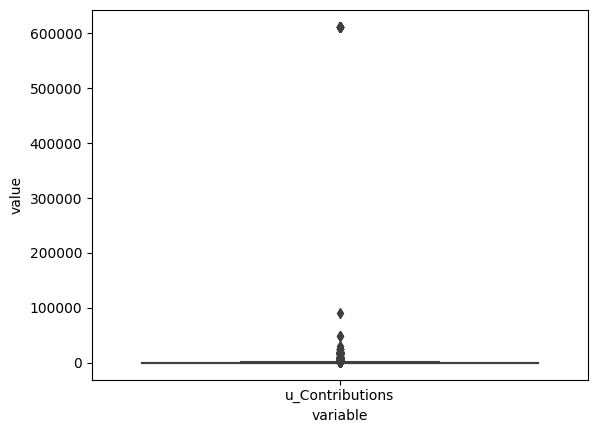

In [50]:
# Graphic box-plot
sns.boxplot(x="variable", y="value", data=pd.melt(df[["u_Contributions"]]))

In [51]:
#We want to make sure that these 611662 u_Contributions are not an error

df[df.u_Contributions > 600000]

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
2287,528086738,Liverpool,UK,611661,Friends,Another beautiful beach ⛱,Just past Costa Adeje is this wonderful beach ...,5.0,2022-01-10,0,...,Playa del Duque,Tenerife,4.5,5667,3325,1841,378,79,44,Beaches
2410,528086738,Liverpool,UK,611661,Friends,Very cool,Located in Safari Shopping Centre is the wonde...,5.0,2021-12-31,1,...,Fountain Las Americas,Tenerife,4.0,2064,934,688,335,82,25,Fountains
3295,528086738,Liverpool,UK,611662,Friends,Exciting area,On our recent eight days holiday in Tenerife w...,5.0,2022-01-01,0,...,Playa De Las Americas,Tenerife,4.0,452,197,154,58,25,19,Beaches
3453,528086738,Liverpool,UK,611662,Friends,Beautiful beach ⛱,Playa De Las Vistas is a wonderful beach in th...,5.0,2021-12-08,0,...,Playa de las Vistas,Tenerife,4.5,3125,1731,1118,220,33,23,Beaches
3521,528086738,Liverpool,UK,611662,Friends,Fabulous,Playa Del Camison is yet another beautiful bea...,5.0,2021-12-10,0,...,Playa del Camison,Tenerife,4.5,376,185,137,39,8,7,Beaches
4258,528086738,Liverpool,UK,611662,Friends,Pretty,La Milla De Oro ( Golden Mile ) is a stretch o...,3.0,2021-12-21,2,...,La Milla De Oro,Tenerife,4.0,156,72,58,17,2,7,Shopping Malls
4486,528086738,Liverpool,UK,611662,Friends,Beautiful beach ⛱,My twin brother Stephen and I were in Tenerife...,5.0,2021-12-10,1,...,Troya Beach,Tenerife,4.0,822,323,326,129,28,16,Beaches
4872,528086738,Liverpool,UK,611662,Friends,5 star beach ⛱,Playa De Fanabe is yet another beautiful beach...,5.0,2022-01-01,1,...,Playa de Fanabe,Tenerife,4.5,2258,1029,884,272,50,23,Beaches
5072,528086738,Liverpool,UK,611662,Friends,Busy,Located around Calle Mexico in Playa De Las Am...,5.0,2022-01-10,2,...,The Patch,Tenerife,4.0,478,212,140,77,19,30,Neighborhoods
5369,528086738,Liverpool,UK,611662,Friends,Busy,My twin brother Stephen and I were on holiday ...,5.0,2021-12-28,0,...,Los Cristianos Harbour,Tenerife,4.0,2679,1136,1060,358,75,50,"Bodies of Water, Beaches"


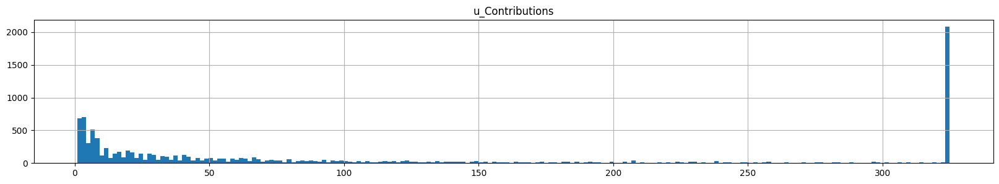

In [52]:
# remove outlier - Due to user with u_Contributions +60000 and to that percentile 75 is 218 according with df.describe()
def outlier_tret(x):
    upper=x.quantile(0.8)
    lower=x.quantile(0.01)
    x=np.where(x>upper,upper,x)
    x=np.where(x<lower,lower,x)
    return x

#eliminate the outliers of the variable
u_Con_plt=df[["u_Contributions"]]
u_Con_plt=u_Con_plt.apply(lambda x: outlier_tret(x))

# Histogram display of the variable
u_Con_plt.hist(figsize=(20,3), bins=200)
plt.show()

In [53]:
#We also want to make sure that these 214 r_Helpful are not an error

df[df.r_Helpful > 200]

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
3144,269361367,Lodz,Poland,3983,Unknown,I liked it a lot,It is especially funny when you are with child...,5.0,2020-03-07,214,...,Monkey Park,Tenerife,4.5,4129,2378,1145,353,107,147,Zoos


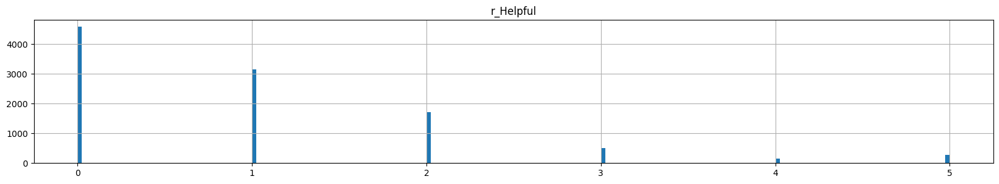

In [54]:
# remove outlier - Due to Review with r_Helpful +200 and to that percentile 75 is 2 according with df.describe()
def outlier_tret(x):
    upper=x.quantile(0.98)
    lower=x.quantile(0.01)
    x=np.where(x>upper,upper,x)
    x=np.where(x<lower,lower,x)
    return x

#eliminate the outliers of the variable
u_Con_plt=df[["r_Helpful"]]
u_Con_plt=u_Con_plt.apply(lambda x: outlier_tret(x))

# Histogram display of the variable
u_Con_plt.hist(figsize=(20,3), bins=200)
plt.show()

Text(0.5, 1.0, 'Distribution of i_Rating')

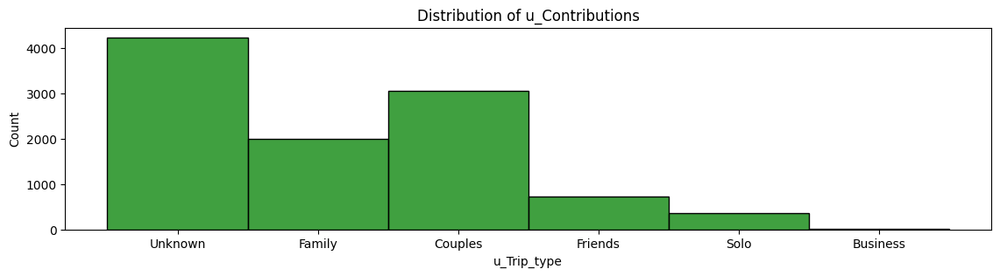

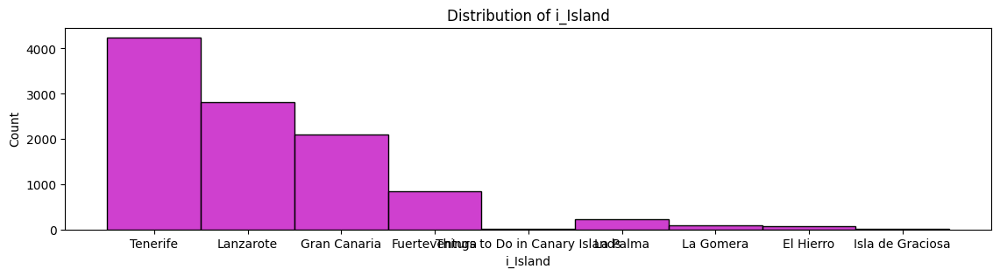

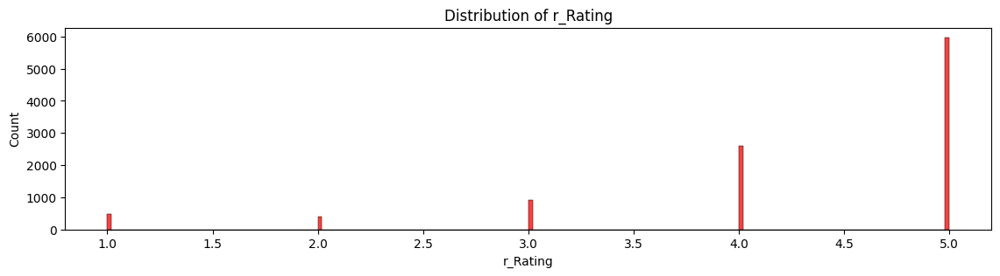

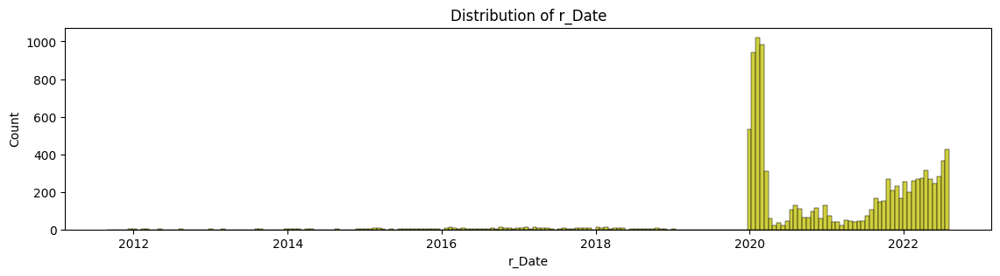

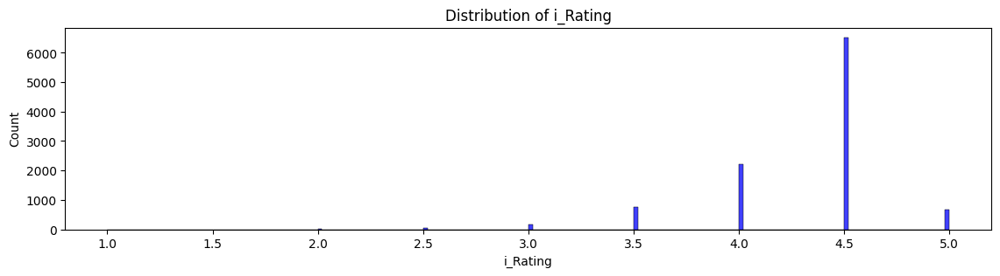

In [55]:
f1 = plt.figure(figsize=(30, 3))

ax = f1.add_subplot(121)
sns.histplot(df['u_Trip_type'], bins=200, color='g', ax=ax)
ax.set_title('Distribution of u_Contributions')

f2 = plt.figure(figsize=(30, 3))

ax = f2.add_subplot(121)
sns.histplot(df['i_Island'], bins=200, color='m', ax=ax)
ax.set_title('Distribution of i_Island')

f3 = plt.figure(figsize=(30, 3))

ax = f3.add_subplot(121)
sns.histplot(df['r_Rating'], bins=200, color='r', ax=ax)
ax.set_title('Distribution of r_Rating')

f4 = plt.figure(figsize=(30, 3))

ax = f4.add_subplot(121)
sns.histplot(df['r_Date'], bins=200, color='y', ax=ax)
ax.set_title('Distribution of r_Date')

f5 = plt.figure(figsize=(30, 3))

ax = f5.add_subplot(121)
sns.histplot(df['i_Rating'], bins=200, color='b', ax=ax)
ax.set_title('Distribution of i_Rating')

**From this visualizations we gather valuable isights: r_Date and i_Island has data that we don't need**

*This is a prove of the power of visualizations when dealing with big data*

In [56]:
# Looking for string/object values

search = df[df.stack().str.contains('horse').unstack().any(1)]
search.head(30)

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
446,543425712,Lund,Sweden,10,Unknown,An admirable rescue centre,I think an important point is that this is a r...,5.0,2022-06-18,0,...,Cocodrilo Park Gran Canaria,Gran Canaria,4.5,1077,616,305,85,30,41,"Parks, Gardens"
450,66714903,Trier,Germany,6,Friends,Great animal rescue park.,Park itself was nice. It clearly advised that ...,4.0,2022-04-02,0,...,Cocodrilo Park Gran Canaria,Gran Canaria,4.5,1077,616,305,85,30,41,"Parks, Gardens"
1762,856826830,Nottinghamshire,UK,46,Unknown,Fantastic day with Nature,Well. Was little curious what will be there......,4.0,2020-03-06,1,...,Loro Parque,Tenerife,4.5,30659,21766,6102,1727,470,597,"Zoos, Aquariums"
2076,574339276,Ilkeston,UK,53,Family,Evening bbq n show,Had a fab time with friends and family for the...,5.0,2022-07-10,1,...,Rancho Texas Lanzarote Park,Lanzarote,4.5,9327,5646,2574,716,225,166,Amusement & Theme Parks
3306,443352346,Cambridge,UK,5209,Friends,Lots happening here,Playa De Las Americas is probably the lovelies...,3.0,2020-07-30,18,...,Playa De Las Americas,Tenerife,4.0,452,197,154,58,25,19,Beaches
4286,435012680,London,UK,124,Unknown,Too windy and rocky to go above halfway up Mon...,We were staying at the Beatriz Spa so already ...,4.0,2020-03-10,0,...,Montana Corona,Lanzarote,4.5,178,114,56,6,2,0,Geologic Formations
4526,426795643,Southend-on-Sea,UK,20,Couples,Not the best,Not the biggest aquarium so didn’t expect much...,3.0,2020-02-27,0,...,Lanzarote Aquarium,Lanzarote,3.5,1423,324,437,408,147,107,Aquariums
4565,758785597,Lillestrom,Norway,6,Unknown,Left in tears,I was really excited to visit this park but un...,1.0,2022-05-15,0,...,Sioux City Park,Gran Canaria,4.5,1274,716,339,115,35,69,Amusement & Theme Parks
4567,797725697,Knegsel,The Netherlands,63,Unknown,enthousiastic staff makes the difference,In the beginning it looked like we would get b...,4.0,2022-05-03,0,...,Sioux City Park,Gran Canaria,4.5,1274,716,339,115,35,69,Amusement & Theme Parks
4568,470521272,Dewsbury,UK,41,Couples,Woman falls of horse.,Park was good. Shows was good Needs more baby ...,4.0,2022-04-29,0,...,Sioux City Park,Gran Canaria,4.5,1274,716,339,115,35,69,Amusement & Theme Parks


In [57]:
# We make some corrections of typos

change_col = ['i_Island']
df[change_col] = df[change_col].replace({'Things to Do in Canary Islands':'La Graciosa'}, regex=True)

change_col = ['i_Island']
df[change_col] = df[change_col].replace({'Isla de Graciosa':'La Graciosa'}, regex=True)

island_col = ['Item']
df[change_col] = df[change_col].replace({'Islas Graciosa':'Isla La Graciosa'}, regex=True)


In [58]:
search = df[df.stack().str.contains('La Graciosa').unstack().any(1)]
search

,u_Id,u_Location,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,...,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
3502,858333698,Hornsea,UK,65,Unknown,relaxing,"stayed here for 2 nights in an airbnb, great v...",5.0,2022-07-27,0,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3503,252070889,Stockport,UK,15,Solo,"Engrossing, immersive La Graciosa",Visually stunning chilled island and a must se...,5.0,2022-04-13,0,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3504,241549980,Munich,Germany,934,Unknown,Little Beautiful Island,It is a little beautiful Island. It is very to...,5.0,2021-10-20,1,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3505,62233177,Cheltenham,UK,68,Couples,Catamaran trip 5 stars from us,"What a fantastic trip, we booked via excursion...",4.0,2021-10-16,1,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3506,908697120,"northampton,england",Unknown,380,Unknown,Must see trip,"Had the pleasure of visiting this peaceful, be...",5.0,2021-01-11,2,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3507,870790535,Almelo,The Netherlands,5,Family,Beautiful island!,I generally do my homework before we make dayt...,5.0,2020-07-17,8,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3508,285772016,Cheshire,Unknown,132,Couples,Peaceful Island,"Boat crushing takes about 30 mins, get there e...",4.0,2020-03-05,4,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3509,988197081,Southport,UK,551,Unknown,Wonderful Island,If you ever wanted to step back in time this i...,5.0,2020-02-16,2,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
3510,654237525,Trieste,Italy,18,Couples,Bellissima,Wonderful wild island. You must to visit it if...,5.0,2020-01-03,1,...,Islas Graciosa,La Graciosa,4.5,731,519,117,48,21,26,Islands
7039,740196857,Bradford,UK,122,Family,Amazing views,We were a bit sceptical about paying €5 each f...,5.0,2022-04-20,0,...,Mirador Del Rio,Lanzarote,4.5,5242,2672,1672,627,174,98,Lookouts


Text(0.5, 1.0, 'Distribution of i_Island')

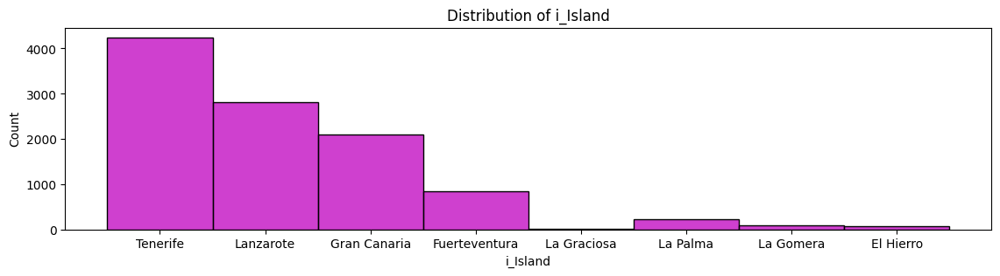

In [59]:
f2 = plt.figure(figsize=(30, 3))

ax = f2.add_subplot(121)
sns.histplot(df['i_Island'], bins=200, color='m', ax=ax)
ax.set_title('Distribution of i_Island')

In [60]:
# Dropping Reviews from before 2020

df = df[~(df['r_Date'] < '2019-12-31')]


Text(0.5, 1.0, 'Distribution of r_Date')

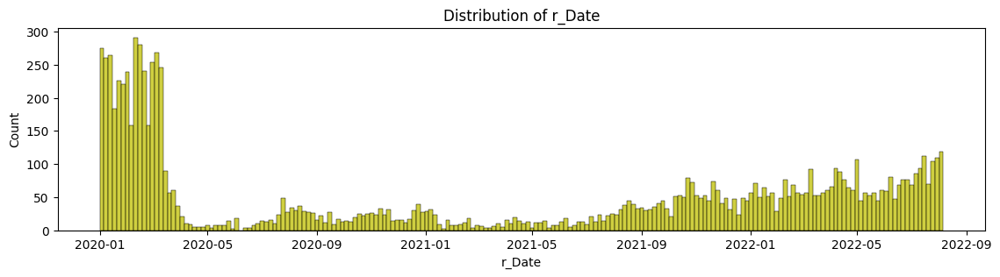

In [61]:
f4 = plt.figure(figsize=(30, 3))

ax = f4.add_subplot(121)
sns.histplot(df['r_Date'], bins=200, color='y', ax=ax)
ax.set_title('Distribution of r_Date')


In [62]:
# Total Contries Table:
table_Country = df.u_Country.value_counts().rename_axis('country').reset_index(name='pop')
pd.set_option("display.max_rows", None, "display.max_columns", None)
table_Country

,country,pop
0,UK,4996
1,Unknown,2149
2,Spain,550
3,Ireland,319
4,Poland,154
5,Sweden,150
6,The Netherlands,134
7,Germany,111
8,Belgium,107
9,Switzerland,104


In [63]:
# Curating u_Country column

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'uk':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'UK':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Scotland.':'Scotland'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'scotland':'Scotland'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'ENGLAND':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'scotland':'Scotland'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Canary Islands':'Spain'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'The Netherland':'Netherlands'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Netherlandss':'Netherlands'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Cheshire':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Staffs':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Kent':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Hertfordshire':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'England':'United Kingdom'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'België':'Belgium'}, regex=True)

change_col = ['u_Country']
df[change_col] = df[change_col].replace({'Belgique':'Belgium'}, regex=True)  

In [64]:
# Curating United States data

df.loc[df['u_Country'].str.len()<3,'u_Country'] = 'United States'

In [65]:
#Once we have deal with them as a 'Objects/Strings' we can set them as the 'Category'

df['u_Id'] = df.u_Id.astype('category')
df['u_Country'] = df.u_Country.astype('category')
df['u_Trip_type'] = df.u_Trip_type.astype('category')
df['Item'] = df.Item.astype('category')
df['i_Island'] = df.i_Island.astype('category')
df['i_Type'] = df.i_Type.astype('category')

In [66]:
# After what we have done, we don't need u_Location anymore

df.drop('u_Location', axis=1, inplace=True)  


In [67]:
table_Item = df.Item.value_counts().rename_axis('Item').reset_index(name='counts')
pd.set_option("display.max_rows", None, "display.max_columns", None)
table_Item.head()

,Item,counts
0,Siam Park,875
1,Loro Parque,388
2,Timanfaya National Park,272
3,Rancho Texas Lanzarote Park,213
4,Barranco del Infierno,203


In [68]:
#After reviewing deeper the data we will drop Attractions containing the following words as Item and i_Type:

df = df[df["Item"].str.contains("Horses|Horse|Patch|Aloha|TENNIS|Tennis") == False]
df.reset_index().head()


,index,u_Id,u_Country,u_Contributions,u_Trip_type,r_Title,r_Core,r_Rating,r_Date,r_Helpful,i_Id,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
0,1,717354021,United Kingdom,7,Unknown,"Worth the trip, cable car needs minimum 90 min...",A great tour and interesting to see what makes...,4.0,2022-07-26,1,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
1,2,946286476,United Kingdom,7,Unknown,Must see of Tenerife,A must see site on Tenerife. You can take eith...,5.0,2022-07-25,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
2,3,784077896,United Kingdom,44,Family,A must visit place in tenerife.,Absolutely awesome place to visit. It's a must...,5.0,2022-07-17,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
3,4,491263,Unknown,8,Family,Hike to the summit.,A drive up to El Tiede from the coast followed...,5.0,2022-07-17,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
4,5,550290313,United Kingdom,52,Couples,Spectacular,"It's number one for a reason. Once up, it's a ...",5.0,2022-07-17,1,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos


In [69]:
# We want to merge r_Title and r_Core since both have information processable and useful for our NLP models. 
df["Review"] = df['r_Title'].astype(str) +" - "+ df["r_Core"]
df.drop('r_Title', inplace=True, axis=1)
df.drop('r_Core', inplace=True, axis=1)
df = df.reindex(['u_Id', 'u_Country', 'u_Contributions', 'u_Trip_type', 'Review', 'r_Rating', 'r_Date', 'r_Helpful', 'i_Id', 'Item', 'i_Island', 'i_Rating', 'i_Reviews', 'i_Excellent', 'i_Very_good', 'i_Average', 'i_Poor', 'i_Terrible', 'i_Type'], axis=1)

In [70]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
u_Contributions,9860.0,1877.317140,26934.984628,1.0,9.0,46.0,208.0,611662.0
r_Rating,9860.0,4.263590,1.092159,1.0,4.0,5.0,5.0,5.0
r_Helpful,9860.0,1.505172,5.854395,0.0,0.0,1.0,2.0,214.0
i_Rating,9860.0,4.314402,0.414742,1.0,4.0,4.5,4.5,5.0
i_Reviews,9860.0,7192.619168,10590.613568,0.0,504.0,2258.0,7960.0,33643.0
i_Excellent,9860.0,4667.815314,7470.846701,0.0,209.0,1073.0,4862.0,23357.0
i_Very_good,9860.0,1670.429006,2089.882514,0.0,154.0,688.0,2199.0,6476.0
i_Average,9860.0,505.109533,621.254874,0.0,48.0,220.0,714.0,1944.0
i_Poor,9860.0,169.084178,251.612304,0.0,9.0,44.0,177.0,828.0
i_Terrible,9860.0,179.507911,313.375039,0.0,3.0,31.0,166.0,1050.0


In [71]:
df.shape

(9860, 19)

In [72]:
df.head()

,u_Id,u_Country,u_Contributions,u_Trip_type,Review,r_Rating,r_Date,r_Helpful,i_Id,Item,i_Island,i_Rating,i_Reviews,i_Excellent,i_Very_good,i_Average,i_Poor,i_Terrible,i_Type
1,717354021,United Kingdom,7,Unknown,"Worth the trip, cable car needs minimum 90 min...",4.0,2022-07-26,1,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
2,946286476,United Kingdom,7,Unknown,Must see of Tenerife - A must see site on Tene...,5.0,2022-07-25,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
3,784077896,United Kingdom,44,Family,A must visit place in tenerife. - Absolutely a...,5.0,2022-07-17,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
4,491263,Unknown,8,Family,Hike to the summit. - A drive up to El Tiede f...,5.0,2022-07-17,0,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos
5,550290313,United Kingdom,52,Couples,Spectacular - It's number one for a reason. O...,5.0,2022-07-17,1,717354021,Volcan El Teide,Tenerife,4.5,13470,9917,2729,552,151,121,Volcanos


In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9860 entries, 1 to 12259
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   u_Id             9860 non-null   category      
 1   u_Country        9860 non-null   category      
 2   u_Contributions  9860 non-null   int32         
 3   u_Trip_type      9860 non-null   category      
 4   Review           9860 non-null   object        
 5   r_Rating         9860 non-null   float64       
 6   r_Date           9860 non-null   datetime64[ns]
 7   r_Helpful        9860 non-null   int32         
 8   i_Id             9860 non-null   object        
 9   Item             9860 non-null   category      
 10  i_Island         9860 non-null   category      
 11  i_Rating         9860 non-null   float64       
 12  i_Reviews        9860 non-null   int32         
 13  i_Excellent      9860 non-null   int32         
 14  i_Very_good      9860 non-null   int32 

**After all the cleaning made, our TripAdvisor data is being reduced a 20,87%, we want to save this 'df' as a new file (csv this time) to speed up our scripting.**

In [74]:
df.to_csv("Cured_ATT.csv", index=False)